### Load Libraries

In [1]:
%load_ext nb_black

# import spacy
# nlp = spacy.load('en_core_web_lg')
import itertools
import pandas as pd
import numpy as np
import os
import glob

pd.set_option('display.max_columns', 150)

from collections import Counter
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import pyplot

import seaborn as sns
from datetime import datetime
from dateutil import parser
import concurrent.futures
import time
import csv
import re
import swifter

# from geopy.geocoders import Nominatim
# geolocator = Nominatim(user_agent="sample app")
# import colorlover as cl
# from IPython.display import HTML

# chosen_colors=cl.scales['7']['qual'][np.random.choice(list(cl.scales['7']['qual'].keys()))]

# print('The color palette chosen for this notebook is:')
# HTML(cl.to_html(chosen_colors))

<IPython.core.display.Javascript object>

In [22]:
len(glob.glob("../Gdelt-data/gdelt-us/2019*"))

5084

In [10]:
!cat /proc/meminfo | grep Mem

MemTotal:       16207904 kB
MemFree:          294000 kB
MemAvailable:    2081512 kB


In [2]:
col = ['date', 'source_name', 
        'themes', 'locations',
        'tone', 'pos', 'neg', 'polarity'
]

def read_files(f):
    start = time.time()
    custom_date_parser = lambda x: datetime.strptime(x, "%Y%m%d%H%M%S")
    chunk = pd.read_csv(f"../gdelt_csv/gdelt_{f}.csv", parse_dates=['date'], date_parser = custom_date_parser, usecols=col, chunksize=1000000)    

    df = pd.concat(chunk)
    del chunk
    df['month'] = df['date'].dt.strftime('%b')
    cats = ['Jan', 'Feb', 'Mar', 'Apr','May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    df['month'] = pd.Categorical(df['month'], ordered=True, categories=cats)
#     df['month'] = df['month'].astype('int8')
    num = df.select_dtypes('number').columns
    df[num] = df[num].swifter.apply(lambda x: pd.to_numeric(x, downcast='float'))
    
    df.loc[:, df.dtypes == 'object'] =\
    df.select_dtypes(['object'])\
    .swifter.apply(lambda x: x.astype('category'))

    end = time.time()
    print(f"Read csv with chunks for {f}: ",round(end-start,2),"sec")

    
    return df

<IPython.core.display.Javascript object>

In [ ]:
%%time
# df_nz = read_files('nz')
# df_au = read_files('au')
# # df_uk = read_files('uk')
# df_us = read_files('us')
# df_ca = read_files('ca')

In [2]:
df = pd.read_feather("../csv/feather/df_ca.feather")


<IPython.core.display.Javascript object>

In [3]:
df.head()

,date,source_name,locations,tone,pos,neg,polarity,month,themes_filtered_Corona,themes_filtered_Vaccination
0,2020-10-22 07:15:00,greenwichtime.com,"2#Maine, United States#US#USME#44.6074#-69.397...",0.513259,3.336185,2.822926,6.159111,Oct,None,None
1,2020-10-22 07:15:00,heraldscotland.com,1#Canada#CA#CA#60#-96#CA;1#United Kingdom#UK#U...,0.707965,1.592920,0.884956,2.477876,Oct,CoronaVirus,None
2,2020-10-22 07:15:00,digitaljournal.com,1#Germany#GM#GM#51.5#10.5#GM;1#Qatar#QA#QA#25....,-4.482759,2.298851,6.781609,9.080460,Oct,None,None
3,2020-10-22 07:15:00,theglobeandmail.com,1#United Kingdom#UK#UK#54#-4#UK;1#Canada#CA#CA...,-0.097276,3.210117,3.307393,6.517510,Oct,None,None
4,2020-10-22 07:15:00,thisislancashire.co.uk,"4#Vancouver Island, British Columbia, Canada#C...",-1.228501,3.931204,5.159705,9.090909,Oct,None,None


<IPython.core.display.Javascript object>

In [4]:
%%time
df_nz = pd.read_feather("../csv/feather/df_nz.feather")
df_au = pd.read_feather("../csv/filtered_themes_regions_feather/df_au.feather")
df_ca = pd.read_feather("../csv/filtered_themes_regions_feather/df_ca.feather")
df_us = pd.read_feather("../csv/filtered_themes_regions_feather/df_us.feather")


CPU times: user 2.99 s, sys: 1.18 s, total: 4.17 s
Wall time: 4.6 s


<IPython.core.display.Javascript object>

In [5]:
df_nz['date'] = pd.to_datetime(df_nz['date'], errors='coerce')
df_au['date'] = pd.to_datetime(df_au['date'], errors='coerce')
df_ca['date'] = pd.to_datetime(df_ca['date'], errors='coerce')
df_us['date'] = pd.to_datetime(df_us['date'], errors='coerce')

<IPython.core.display.Javascript object>

In [37]:
df_ca.head()

,date,source_name,tone,pos,neg,polarity,month,themes_filtered_Corona,themes_filtered_Vaccination,Region,Sentiment,country
0,2020-10-22,greenwichtime.com,0.513259,3.336185,2.822926,6.159111,Oct,None,None,[Canada (General)],Positive,CA
1,2020-10-22,heraldscotland.com,0.707965,1.592920,0.884956,2.477876,Oct,CoronaVirus,None,[Canada (General)],Positive,CA
2,2020-10-22,digitaljournal.com,-4.482759,2.298851,6.781609,9.080460,Oct,None,None,[Canada (General)],Negative,CA
3,2020-10-22,theglobeandmail.com,-0.097276,3.210117,3.307393,6.517510,Oct,None,None,[vancouver],Negative,CA
4,2020-10-22,thisislancashire.co.uk,-1.228501,3.931204,5.159705,9.090909,Oct,None,None,[vancouver],Negative,CA


<IPython.core.display.Javascript object>

In [25]:
df_nz.to_csv("df_nz_filter.csv", index=False)

<IPython.core.display.Javascript object>

In [23]:
df_nz['Region'] = df_nz['Region'].apply(lambda x: 'manawatu-Whanganui' if x in ['whanganui', 'manawatu'] else x)

<IPython.core.display.Javascript object>

In [6]:
# df_nz = df_nz.loc[df_nz.date.dt.year == 2020]  ## for 2020
# df_au = df_au.loc[df_au.date.dt.year == 2020]  ## for 2020
# df_ca = df_ca.loc[df_ca.date.dt.year == 2020]  ## for 2020
# df_us = df_us.loc[df_us.date.dt.year == 2020]  ## for 2020

<IPython.core.display.Javascript object>

In [7]:
# %%time

# df_nz.reset_index(drop = True).to_feather("../csv/filtered_themes_regions_feather/df_nz.feather")
# df_au.reset_index(drop = True).to_feather("../csv/filtered_themes_regions_feather/df_au.feather")
# df_ca.reset_index(drop = True).to_feather("../csv/filtered_themes_regions_feather/df_ca.feather")
# df_us.reset_index(drop = True).to_feather("../csv/filtered_themes_regions_feather/df_us.feather")

<IPython.core.display.Javascript object>

In [4]:
# Region CSV

# au = pd.read_csv("../au.csv") # extracting Australia cities
# # uk = pd.read_csv("../Gdelt_scripts/gb.csv")    
# us = pd.read_csv("../Gdelt_scripts/uscities.csv")
# ca = pd.read_excel("../Gdelt_scripts/canadacities.xlsx")

nz = [
    "Northland", "Auckland", "Waikato", "Bay of Plenty", "Gisborne", 
    "Hawke's Bay", "Taranaki", "Manawatu", "Whanganui", "Wellington", "Tasman",
    "Nelson", "Marlborough", "West Coast", "Canterbury", "Otago", "Southland"
]
# au = list(au['city'].unique())[:15]
# us = list(us.city.unique())[:15]
# # uk = list(uk.city.unique())[:15]
# ca = list(ca['city'].unique())[:15]

<IPython.core.display.Javascript object>

In [5]:
# data = [geolocator.geocode(x) for x in nz]
# d = list(itertools.chain(*data))
# d = dict(itertools.zip_longest(*[iter(d)] * 2, fillvalue=""))
# d = {key.split(',')[0]:value for key,value in d.items()}
# d2 = {'New Zealand (General)': (-41.5000831, 172.8344077)}
# d.update(d2)

<IPython.core.display.Javascript object>

In [65]:
df_nz.query('themes_filtered_Vaccination == "Vaccination"').groupby(['month','country']).agg({'tone':'mean'}).reset_index()

,month,country,tone
0,Jan,NZ,-2.253908
1,Feb,NZ,-3.226971
2,Mar,NZ,-2.662617
3,Apr,NZ,-2.791018
4,May,NZ,-2.637205
5,Jun,NZ,-3.077157
6,Jul,NZ,-1.914574
7,Aug,NZ,-2.511679
8,Sep,NZ,-2.728550
9,Oct,NZ,-2.657312


<IPython.core.display.Javascript object>

### Time Series

In [7]:
def group_df(df,f, i):

    df['country'] = f

    if i == 0:
        df['date'] = pd.to_datetime(df['date'], errors='coerce')
        df['date'] = df.date.dt.date
        df = df.groupby(['date'], as_index=False).agg({'tone':'mean', 'source_name':'count'})
        df['rolling_7'] = df.tone.rolling(7).mean()
        df['country'] = f
    
    elif i == 1:
        df = df.query('themes_filtered_Corona == "CoronaVirus"').groupby(['month','country']).agg({'tone':'mean'}).reset_index()
    
    else:
        df = df.query('themes_filtered_Vaccination == "Vaccination"').groupby(['month','country']).agg({'tone':'mean'}).reset_index()

    return df
    


<IPython.core.display.Javascript object>

### Corona Virus Theme Filtered

In [11]:
ts_nz = group_df(df_nz,'NZ',1)
ts_au = group_df(df_au,'AU',1)
# ts_uk = group_df(df_uk,'UK',0)
ts_us = group_df(df_us,'US',1)
ts_ca = group_df(df_ca,'CA',1)
ts_country = pd.concat([ts_nz,ts_au,ts_us,ts_ca])


<IPython.core.display.Javascript object>

### Vaccination themes

In [68]:
ts_nz = group_df(df_nz,'NZ',2)
ts_au = group_df(df_au,'AU',2)
# ts_uk = group_df(df_uk,'UK',0)
ts_us = group_df(df_us,'US',2)
ts_ca = group_df(df_ca,'CA',2)
ts_country = pd.concat([ts_nz,ts_au,ts_us,ts_ca])


<IPython.core.display.Javascript object>

In [57]:
df_nz['date'] = df_nz.date.dt.date
df_nz.query('themes_filtered_Corona == "CoronaVirus"').groupby(['date']).tone.mean().reset_index()#.drop('level_1', axis=1)

,date,tone
0,2020-01-09,-0.054945
1,2020-01-14,-5.845786
2,2020-01-15,-2.872537
3,2020-01-16,1.096121
4,2020-01-17,-4.854369
...,...,...
348,2020-12-27,-1.805616
349,2020-12-28,-1.932768
350,2020-12-29,-1.143775
351,2020-12-30,-1.005862


<IPython.core.display.Javascript object>

In [14]:
colors_div = ['#D3B651','lightgreen', '#6351D3', '#D35151','aqua']

<IPython.core.display.Javascript object>

#### Corona Time series

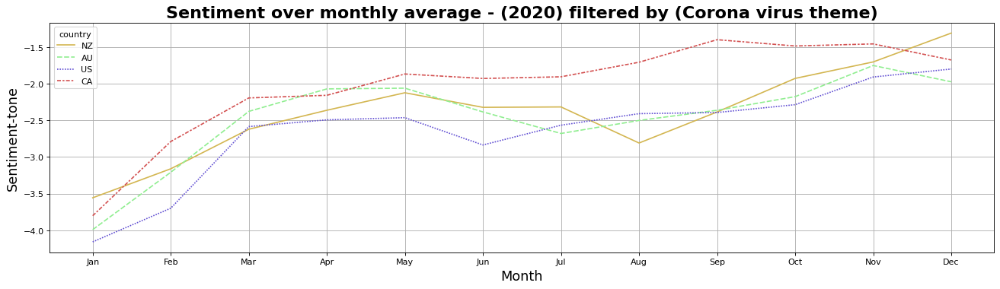

<IPython.core.display.Javascript object>

In [15]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

sns.set_palette(sns.color_palette(colors_div))
sns.lineplot(x='month', y='tone', data=ts_country, hue = 'country', style = 'country',hue_order= ts_country.country.unique())


ax.set_title('Sentiment over monthly average - (2020) filtered by (Corona virus theme)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Month', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(title = 'country', loc = 'best',fontsize = 10)

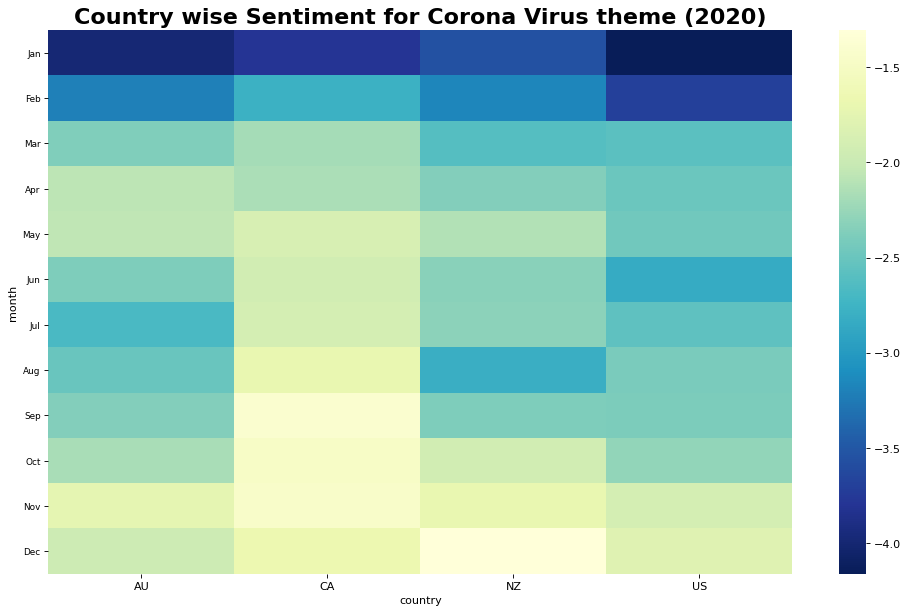

<IPython.core.display.Javascript object>

In [16]:
fig, ax = plt.subplots(figsize=(15, 9), dpi = 80)

sns.heatmap(ts_country.pivot('month', 'country', 'tone'), annot=False, cmap="YlGnBu_r", ax=ax)
plt.title("Country wise Sentiment for Corona Virus theme (2020)", fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 8);
plt.show()

#### Vaccination Time series

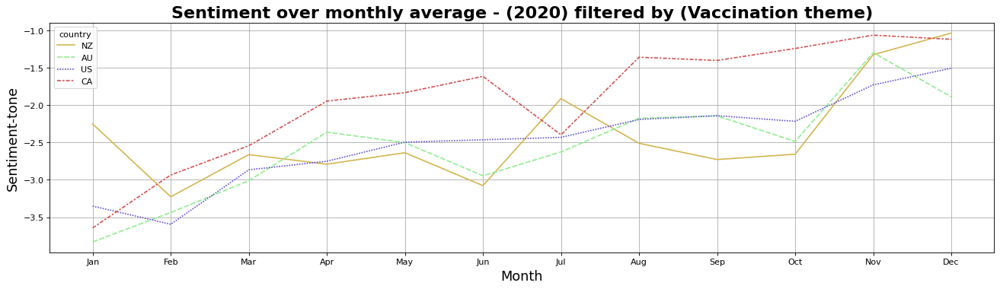

<IPython.core.display.Javascript object>

In [70]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

sns.set_palette(sns.color_palette(colors_div))
sns.lineplot(x='month', y='tone', data=ts_country, hue = 'country', style = 'country',hue_order= ts_country.country.unique())


ax.set_title('Sentiment over monthly average - (2020) filtered by (Vaccination theme)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Month', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(title = 'country', loc = 'best',fontsize = 10)

In [8]:
ts_nz = group_df(df_nz,'NZ',0)
ts_au = group_df(df_au,'AU',0)
# ts_uk = group_df(df_uk,'UK',0)
ts_us = group_df(df_us,'US',0)
ts_ca = group_df(df_ca,'CA',0)
ts_country = pd.concat([ts_nz,ts_au,ts_us,ts_ca])
ts_country['month'] = [d.strftime('%b') for d in ts_country.date]
ts_country['date'] = pd.to_datetime(ts_country['date'], errors='coerce')
ts_country = ts_country.loc[ts_country.date.dt.year == 2020]
ts_country.rename(columns = {'source_name':'Articles'}, inplace = True)

<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'No. of news articles monthly - (2020)')

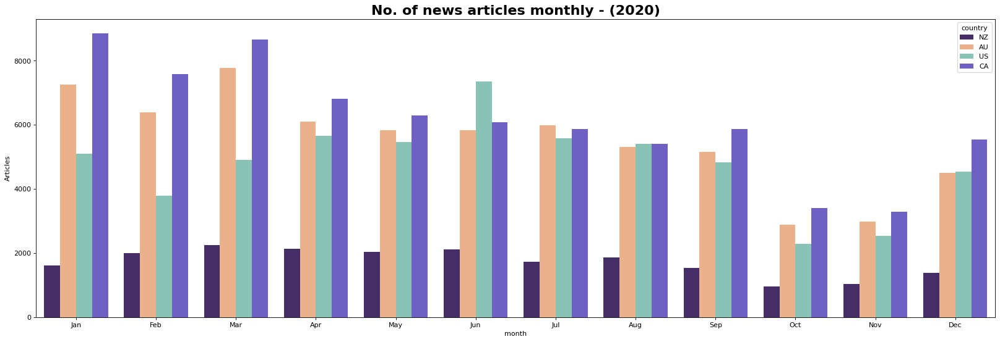

<IPython.core.display.Javascript object>

In [43]:
fig, ax = plt.subplots(figsize=(25, 8), dpi = 80)

ax = sns.barplot(x=ts_country.month, y="Articles", data=ts_country, ci=None, hue= 'country',hue_order= ts_country.country.unique().tolist(),palette=['#432371',"#FAAE7B", "#7fcdbb","#6351D3"])
ax.set_title('No. of news articles monthly - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))


Text(0.5, 1.0, 'Sentiment distribution - (2020)')

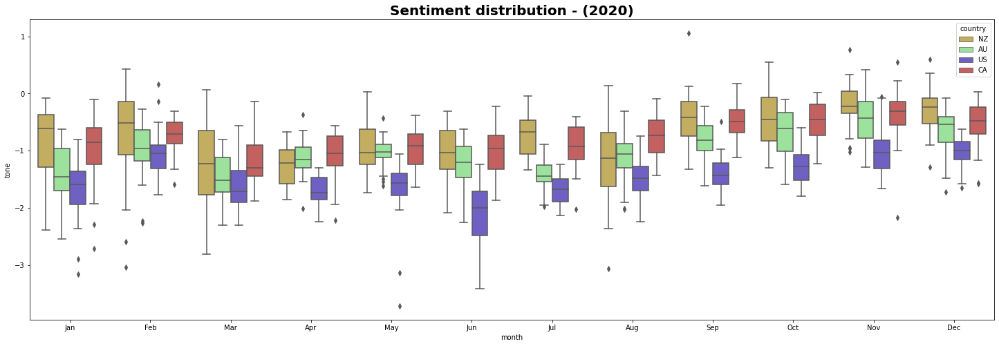

<IPython.core.display.Javascript object>

In [19]:
fig, ax = plt.subplots(figsize=(25, 8))
sns.set_palette(sns.color_palette(colors_div))

sns.boxplot(x = 'month', y='tone', data = ts_country, hue='country',hue_order= ts_country.country.unique().tolist())
ax.set_title('Sentiment distribution - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))


#### CSV - 2

In [20]:
# ts_country.pivot(index='date', columns = 'country', values='Articles').reset_index().to_csv('../csv/country_total_articles.csv', index=False)  ## CSV - 2

<IPython.core.display.Javascript object>

#### CSV - 1

In [11]:
# ts = ts_country.groupby('country').resample('M', on='date').agg({'tone':'mean'}).reset_index().set_index(['date','country']).unstack()
# ts.columns = [col[1] for col in ts.columns.values]
# ts.reset_index(drop = False).to_csv('../csv/country_sentiment_monthly.csv', index=False)         ## CSV-1
# del ts

<IPython.core.display.Javascript object>

In [15]:
# import boto3
# def upload_to_s3(filename):
#     session = boto3.Session(profile_name='kandavar')
#     dev_s3_client = session.client('s3')
#     bucket_name = 'statsnz-covid-kandavar'
#     file_name = '../csv/country_sentiment_monthly.csv'
#     dev_s3_client.put_object(Body=open(file_name, 'rb'), Bucket = bucket_name, Key = filename)

# upload_to_s3("csv/country_sentiment_monthly.csv")

<IPython.core.display.Javascript object>

#### CSV - 0

In [22]:
# ts_country.dropna(subset=['rolling_7'], how='any', inplace=True)
# ts = ts_country[['date', 'rolling_7','country']].set_index(['date', 'country']).unstack()
# ts.columns = [col[1] for col in ts.columns.values]
# ts.reset_index(drop = False).to_csv('../csv/country_sentiment_rolling_avg.csv', index=False)         ## CSV-0
# del ts

<IPython.core.display.Javascript object>

#### CSV - 1.5

In [23]:
# ts = ts_country.groupby('country').resample('W-MON', on='date').agg({'tone':'mean'}).unstack(0).reset_index()   ## CSV - 1.5
# ts.columns = [col[1] for col in ts.columns.values]
# ts.columns.values[0] = 'date'
# ts.to_csv('../csv/country_sentiment_weekly.csv', index = False)
# del ts

<IPython.core.display.Javascript object>

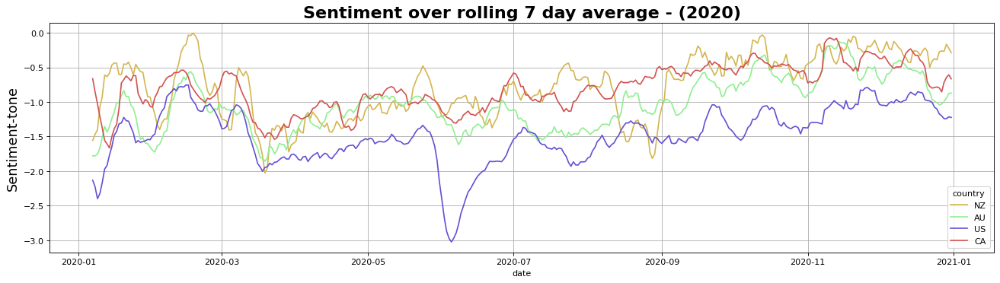

<IPython.core.display.Javascript object>

In [24]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

sns.set_palette(sns.color_palette(colors_div))
sns.lineplot(x='date', y='rolling_7', data=ts_country.dropna(subset=['rolling_7'], how='any'), hue = 'country')


ax.set_title('Sentiment over rolling 7 day average - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
# ax.set_xlabel('date', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(title = 'country', loc = 'best',fontsize = 10)

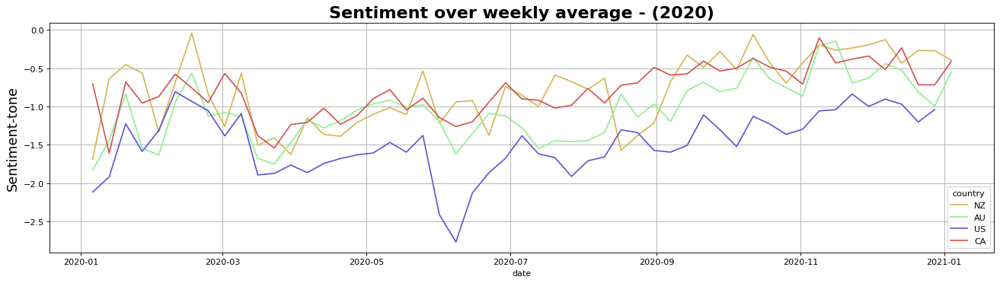

<IPython.core.display.Javascript object>

In [25]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

sns.set_palette(sns.color_palette(colors_div))

sns.lineplot(x='date', y='tone', data=ts_country.groupby('country').resample('W-MON', on='date').agg({'tone':'mean'}).reset_index(), hue = 'country', hue_order= ts_country.country.unique().tolist())


ax.set_title('Sentiment over weekly average - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
# ax.set_xlabel('week', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(title = 'country', loc = 'best',fontsize = 10)

In [26]:
# ts_country.groupby([ts_country.date.dt.month, 'month', 'country'], as_index=False).agg({'tone': 'mean'})

<IPython.core.display.Javascript object>

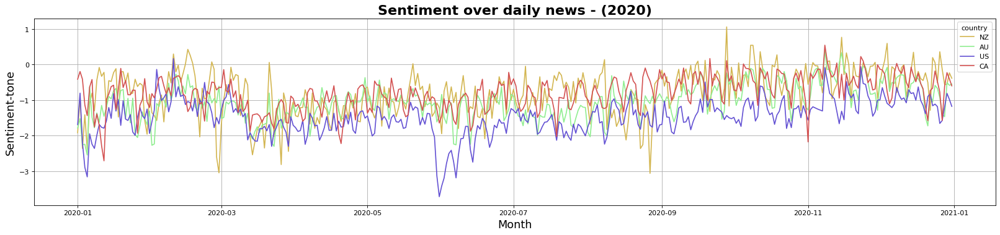

<IPython.core.display.Javascript object>

In [27]:
fig, ax = plt.subplots(figsize=(25, 5), dpi = 80)

sns.set_palette(sns.color_palette(colors_div))

sns.lineplot(x='date', y='tone', data=ts_country, hue = 'country', hue_order=ts_country.country.unique().tolist())


ax.set_title('Sentiment over daily news - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Month', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(title = 'country', loc = 'best',fontsize = 10)

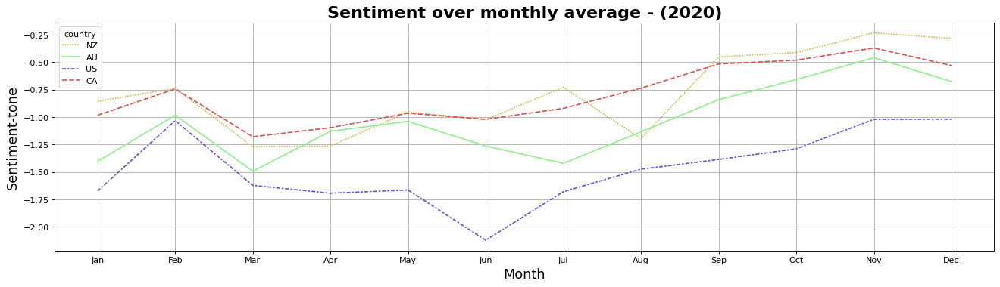

<IPython.core.display.Javascript object>

In [28]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

sns.set_palette(sns.color_palette(colors_div))
sns.lineplot(x='month', y='tone', data=ts_country.groupby([ts_country.date.dt.month, 'month', 'country'], as_index=False).agg({'tone': 'mean'}), hue = 'country', style = 'country', hue_order=ts_country.country.unique().tolist())


ax.set_title('Sentiment over monthly average - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Month', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(title = 'country', loc = 'best',fontsize = 10)

In [29]:
# def reg_lis_str(df):
#     df['Region'] = df['Region'].agg(lambda x: ','.join(map(str, x)))
    
#     return df
# df_nz = reg_lis_str(df_nz)
# df_au = reg_lis_str(df_au)
# df_uk = reg_lis_str(df_uk)
# df_us = reg_lis_str(df_us)
# df_ca = reg_lis_str(df_ca)

<IPython.core.display.Javascript object>

### Region wise

In [7]:
df_nz.head()

,date,source_name,themes,locations,tone,pos,neg,polarity,month
0,2021-02-01 17:00:00,adn.com,TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;GENERAL_HE...,"2#New York, United States#US#USNY#42.1497#-74....",-1.545254,2.980132,4.525386,7.505519,Feb
1,2021-02-01 17:00:00,fandompost.com,SOVEREIGNTY;TAX_FNCACT;TAX_FNCACT_DIRECTOR;TAX...,1#South Africa#SF#SF#-30#26#SF;1#Australia#AS#...,-0.358423,0.716846,1.075269,1.792115,Feb
2,2021-02-01 17:00:00,abc11.com,TAX_FNCACT;TAX_FNCACT_GARDENER;WB_678_DIGITAL_...,"2#Delaware, United States#US#USDE#39.3498#-75....",0.930233,3.023256,2.093023,5.116279,Feb
3,2021-02-01 17:00:00,stuff.co.nz,MANMADE_DISASTER_IMPLIED;TAX_WORLDLANGUAGES;TA...,"5#Taranaki, Taranaki, New Zealand#NZ#NZF9#-39....",-0.330033,1.980198,2.310231,4.290429,Feb
4,2021-02-01 17:00:00,theguardian.com,TAX_WORLDMAMMALS;TAX_WORLDMAMMALS_HUMAN;UNGP_F...,1#Mexico#MX#MX#23#-102#MX;1#Australia#AS#AS#-2...,-2.151899,1.265823,3.417722,4.683544,Feb


<IPython.core.display.Javascript object>

In [6]:
def region(df, regions):
    df['locations'] = df.locations.str.lower()
    regions = [r.lower() for r in regions]
    df['Region']=df['locations'].str.findall(r"|".join(regions)).swifter.apply(", ".join)
    
    return df

df_nz = region(df_nz, nz) 

# df_au = region(df_au, au)
# # df_uk = region(df_uk, uk)
# df_us = region(df_us, us)
# df_ca = region(df_ca, ca)

Pandas Apply:   0%|          | 0/901499 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

In [17]:
# df_nz.explode('Region').Region.apply(lambda x: 'manawatu-Whanganui' if x in ['whanganui', 'manawatu'] else x)

<IPython.core.display.Javascript object>

In [8]:
def region_list(region, f):
    
    region = region.split(',')
    region = [region.replace(' ', '') for region in region]
#     region = list(filter(lambda x: x.strip(), region))
    region = list(set(region))
    region = [f if region == '' else region for region in region]
    
    return region

df_nz['Region'] = df_nz['Region'].swifter.apply(lambda x: region_list(x, "New Zealand (General)"))
# df_au['Region'] = df_au['Region'].swifter.apply(lambda x: region_list(x, "Australia (General)"))
# # df_uk['Region'] = df_uk['Region'].swifter.apply(lambda x: region_list(x, "United Kingdom (General)"))
# df_us['Region'] = df_us['Region'].swifter.apply(lambda x: region_list(x, "United States (General)"))
# df_ca['Region'] = df_ca['Region'].swifter.apply(lambda x: region_list(x, "Canada (General)"))


Pandas Apply:   0%|          | 0/901499 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

In [18]:
def plot_region(df, f):
    plt.figure(figsize=(20,9), dpi = 80)
    ax=sns.barplot(x='Region' ,y='index',data=df.explode('Region').Region.value_counts().to_frame().reset_index())
    total = float(len(df))
    for p in ax.patches:
        width = p.get_width()    
        ax.text(width + 1,      
                p.get_y() + p.get_height() / 2, 
                '{:.1f}%'.format(100 * width/total),
                ha = 'left',   
                va = 'center')  
    plt.title(f"Top News Region wise in 2020 - {f}")
    return plt.show()

<IPython.core.display.Javascript object>

In [ ]:
plot_region(df_nz, 'New Zealand')
plot_region(df_au, 'Australia')
# plot_region(df_uk, 'United Kingdom')
plot_region(df_us, 'United States Of America')
plot_region(df_ca, 'Canada')

In [10]:
def sentiment(*data):
    for df in data:
        df['Sentiment'] = df['tone'].swifter.apply(lambda x: "Positive" if x>0 else ("Neutral" if x==0 else "Negative"))


<IPython.core.display.Javascript object>

In [11]:
sentiment(df_nz)#, df_au, df_us, df_ca)

Dask Apply:   0%|          | 0/8 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

In [21]:
def plot_reg_senti(*data):
    for df in data:
        plt.figure(figsize=(20,8), dpi = 80)
        ax=sns.countplot(y=df.explode('Region').Region ,data=df, hue = df.explode('Region').Sentiment, order = df.explode('Region').Region.value_counts().to_frame().reset_index()['index'].tolist()[:6])
        total = float(len(df))
        for p in ax.patches:
            width = p.get_width()    # get bar length
            ax.text(width + 1,       # set the text at 1 unit right of the bar
                    p.get_y() + p.get_height() / 2, # get Y coordinate + X coordinate / 2
                    '{:.1f}%'.format(100 * width/ total), # set variable to display
                    ha = 'left',   # horizontal alignment
                    va = 'center')  # vertical alignment
        plt.legend(title = 'Sentiment', loc = 'best',fontsize = 10)
        plt.title(f" Region wise Sentiment in 2020 - {' '.join(df.explode('Region').Region.value_counts().to_frame().index[0].split(' ')[:-1])}")
        
        

<IPython.core.display.Javascript object>

In [ ]:
plot_reg_senti(df_nz, df_au, df_us, df_ca)

In [ ]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

# palette = sns.color_palette("bright", 5)
sns.lineplot(x='month', y='tone', data=df_nz.explode('Region').groupby(['Region','month']).agg({'tone':'mean'}).reset_index(), hue = 'Region', hue_order= df_nz.explode('Region').Region.value_counts().to_frame().reset_index()['index'].tolist()[1:6], legend= False, style = 'Region')#,palette=palette)


ax.set_title('Sentiment region wise NZ - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Month', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)

# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
# plt.legend( ['Wellington', 'Auckland', 'Otago', 'Waikato', 'Northland'], title = 'Region', loc = 'lower right')


bbox = dict(boxstyle ="round", fc ="1")
arrowprops = dict(
    arrowstyle = "->")#,
#     connectionstyle = "angle, angleA = 20, \
#     angleB = 20, rad = 10", lw = 0.5)
   
offset = 20

def tex(name,a, b):
    text = ax.annotate(name,
                   xy=(x, y),
                    xytext=(a * offset, b* offset),
                   color=line.get_color(),
                      xycoords=(ax.get_xaxis_transform(),
                 ax.get_yaxis_transform()),
                  textcoords="offset points",bbox = bbox, arrowprops = arrowprops)

    
    return text

for line, name in zip(ax.lines, ['Wellington', 'Auckland', 'Otago', 'Waikato', 'Northland']):
    y = line.get_ydata()[-1]
    x = line.get_xdata()[-1]
    if not np.isfinite(y):
        y=next(reversed(line.get_ydata()[~line.get_ydata().mask]),float("nan"))
    if not np.isfinite(y) or not np.isfinite(x): 
        continue
    
    
    
    if name in (['Wellington']):
        
        text = tex(name, 1, 0)

        text_width = (text.get_window_extent(
        fig.canvas.get_renderer()).transformed(ax.transData.inverted()).width)
        if np.isfinite(text_width):
            ax.set_xlim(ax.get_xlim()[0], text.xy[0] + text_width * 2.05)    
    
    elif name in (['Auckland']):
        text = tex(name, 2, -1.0)

        text_width = (text.get_window_extent(
        fig.canvas.get_renderer()).transformed(ax.transData.inverted()).width)
        if np.isfinite(text_width):
            ax.set_xlim(ax.get_xlim()[0], text.xy[0] + text_width * 2.05)    
            
    elif name in (['Otago']):
        text = tex(name, 4, 1)

        text_width = (text.get_window_extent(
        fig.canvas.get_renderer()).transformed(ax.transData.inverted()).width)
        if np.isfinite(text_width):
            ax.set_xlim(ax.get_xlim()[0], text.xy[0] + text_width * 2.05)    

    elif name in (['Waikato']):
        text = tex(name, 2, 3)

        text_width = (text.get_window_extent(
        fig.canvas.get_renderer()).transformed(ax.transData.inverted()).width)
        if np.isfinite(text_width):
            ax.set_xlim(ax.get_xlim()[0], text.xy[0] + text_width * 2.05)  
            
    else:
        text = tex(name, 1.5, 1)
        

        text_width = (text.get_window_extent(
        fig.canvas.get_renderer()).transformed(ax.transData.inverted()).width)
        if np.isfinite(text_width):
            ax.set_xlim(ax.get_xlim()[0], text.xy[0] + text_width * 2.05)      
    

#### CSV - 6

In [73]:
# ts = df_nz.explode('Region').groupby(['date','Region']).agg({'source_name':'count'}).reset_index().set_index(['date','Region']).unstack().fillna(0)
# ts.columns = [col[1] for col in ts.columns.values]
# ts.columns = ts.columns.str.capitalize()
# ts.reset_index(drop = False).to_csv('../csv/Region_articles_timeseries.csv', index=False)         ## CSV-6
# del ts

<IPython.core.display.Javascript object>

### Themes

In [12]:
df_nz.reset_index(drop = True).to_feather('../csv/feather/df_nz.feather')
# df_au.reset_index(drop = True).to_feather('../csv/feather/df_au.feather')
# df_ca.reset_index(drop = True).to_feather('../csv/feather/df_ca.feather')

<IPython.core.display.Javascript object>

In [15]:
# df_nz.to_pickle("../csv/hdf/df_nz.pkl")
# df_au.to_pickle("../csv/hdf/df_au.pkl")
# df_ca.to_pickle("../csv/hdf/df_ca.pkl")
# df_us.to_pickle("../csv/hdf/df_us.pkl")

<IPython.core.display.Javascript object>

In [ ]:
themes = ['tax_disease_coronavirus','tax_disease_coronavirus_infections','tax_disease_coronaviruses']

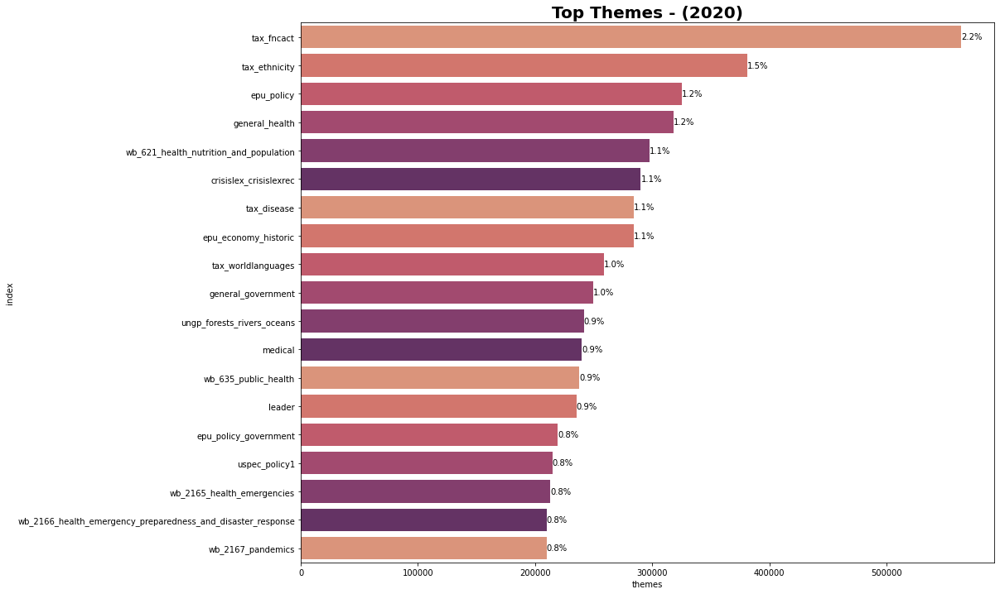

<IPython.core.display.Javascript object>

In [20]:
fig, ax = plt.subplots(figsize=(15, 12))
palette = sns.color_palette("flare")
ax = sns.barplot(y='index', x='themes', data=df_nz.explode('themes').themes.value_counts().to_frame().reset_index().iloc[1:20,:], palette=palette)#, order=df_nz.explode('themes').themes.value_counts().index[1:10])
ax.set_title('Top Themes - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
total = float(len(df_nz.explode('themes')))
for p in ax.patches:
    width = p.get_width()    
    ax.text(width + 1,       
            p.get_y() + p.get_height() / 2, 
            '{:.1f}%'.format(100 * width/ total), 
            ha = 'left',  
            va = 'center')  

Text(0.5, 1.0, 'No. of News Articles on Coronavirus Themes - (2020) NZ')

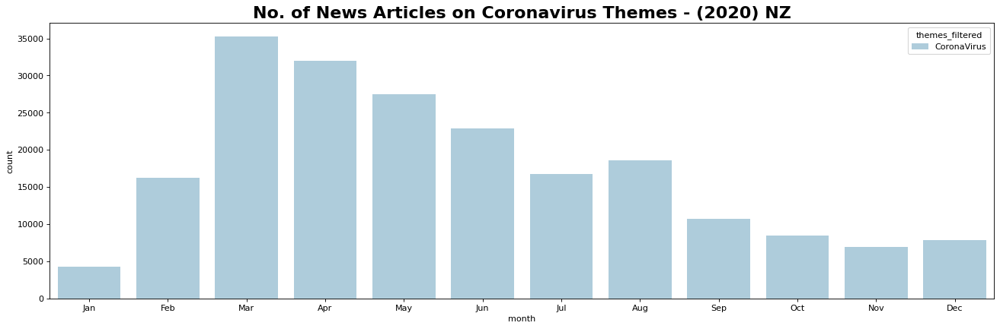

<IPython.core.display.Javascript object>

In [24]:
fig, ax = plt.subplots(figsize=(20, 6), dpi = 80)
pallette =sns.color_palette("Paired")
ax = sns.countplot(x='month', data=df_nz, hue= 'themes_filtered', palette=pallette)
ax.set_title('No. of News Articles on Coronavirus Themes - (2020) NZ',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))

# for p in ax.patches:
#     ax.annotate(f'\n{p.get_height()}', (p.get_x()+0.2, p.get_height()), ha='center', va='top', color='Black', size=12)

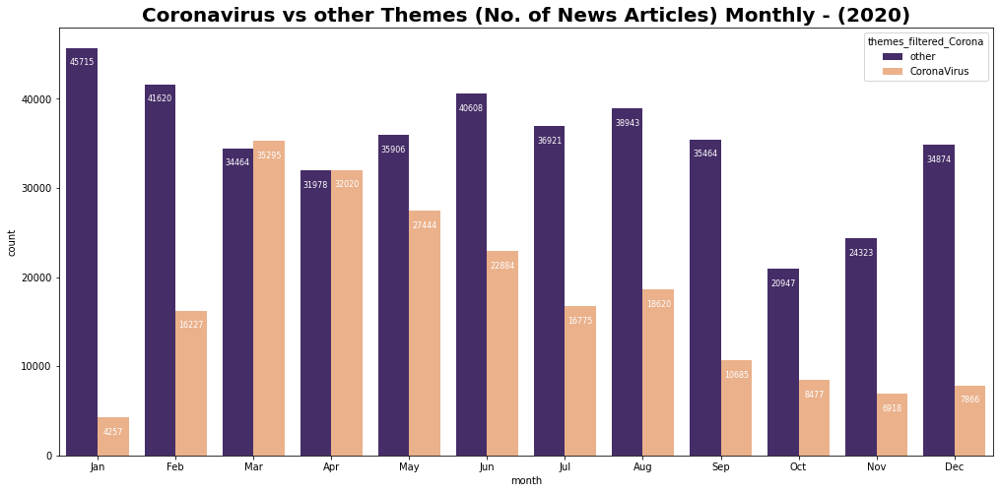

<IPython.core.display.Javascript object>

In [14]:
fig, ax = plt.subplots(figsize=(17, 8))#, dpi = 80)
# palette = sns.color_palette("Paired")
ax = sns.countplot(x='month', data=df_nz, hue= df_nz['themes_filtered_Corona'].fillna('other'), palette= ['#432371',"#FAAE7B"])
ax.set_title('Coronavirus vs other Themes (No. of News Articles) Monthly - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
for p in ax.patches:
    ax.annotate(f'\n{p.get_height()}', (p.get_x()+0.2, p.get_height()), ha='center', va='top', color='White', size=8)

plt.savefig("Corona-Articles")

In [28]:
df_nz['themes_filtered_Corona'] = df_nz['themes_filtered_Corona'].fillna('other')

<IPython.core.display.Javascript object>

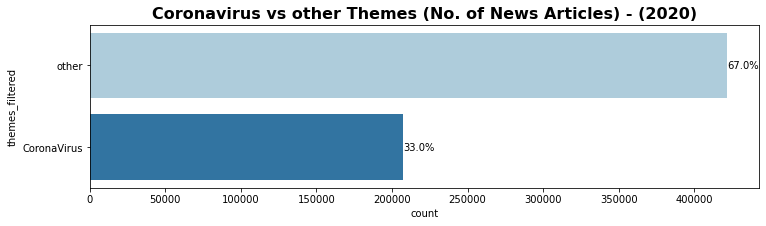

<IPython.core.display.Javascript object>

In [53]:
fig, ax = plt.subplots(figsize=(12, 3))
palette = sns.color_palette("Paired")
ax = sns.countplot(y='themes_filtered', data=df_nz, palette= palette)
ax.set_title('Coronavirus vs other Themes (No. of News Articles) - (2020)',  fontsize = 16, loc='center', fontdict=dict(weight='bold'))
total = float(len(df_nz))
for p in ax.patches:
    width = p.get_width()    
    ax.text(width + 1,       
            p.get_y() + p.get_height() / 2, 
            '{:.1f}%'.format(100 * width/ total), 
            ha = 'left',  
            va = 'center')  


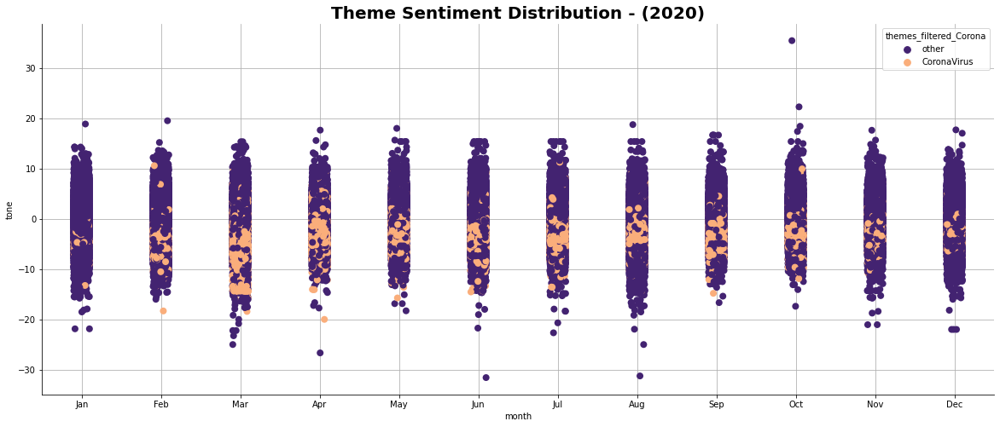

<IPython.core.display.Javascript object>

In [39]:
fig, ax = plt.subplots(figsize=(20, 8))
# sns.set_palette(sns.color_palette(colors_div))
sns.stripplot(x = "month",
              y = "tone",
              data = df_nz,
              hue ="themes_filtered_Corona",
              jitter = True,
              ax = ax,
              s = 8,
              palette= ['#432371',"#FAAE7B"]
)
sns.despine(right = True)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
ax.set_title('Theme Sentiment Distribution - (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
plt.savefig("Corona-theme-dist")
plt.show()


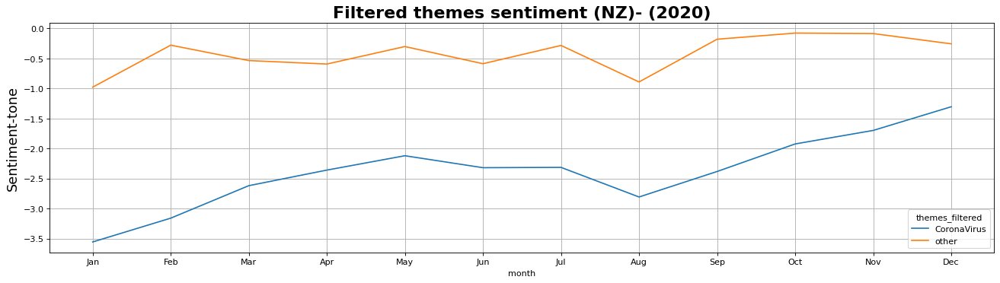

<IPython.core.display.Javascript object>

In [33]:
fig, ax = plt.subplots(figsize=(20, 5), dpi = 80)

# colors_div = ["#132C33", '#17869E']
# sns.set_palette(sns.color_palette(colors_div))
sns.lineplot(x='month', y='tone', data=df_nz.groupby(['month', 'themes_filtered']).agg({'tone':'mean'}).reset_index(), hue = 'themes_filtered')


ax.set_title('Filtered themes sentiment (NZ)- (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))
# ax.set_xlabel('week', fontsize = 16)
ax.set_ylabel('Sentiment-tone', fontsize = 16)
ax.xaxis.grid(True)
ax.yaxis.grid(True)
# plt.tick_params(axis='y', which='major', labelsize=16)
# plt.tick_params(axis='x', which='major', labelsize=16)
# plt.legend(title = 'country', loc = 'best',fontsize = 10)

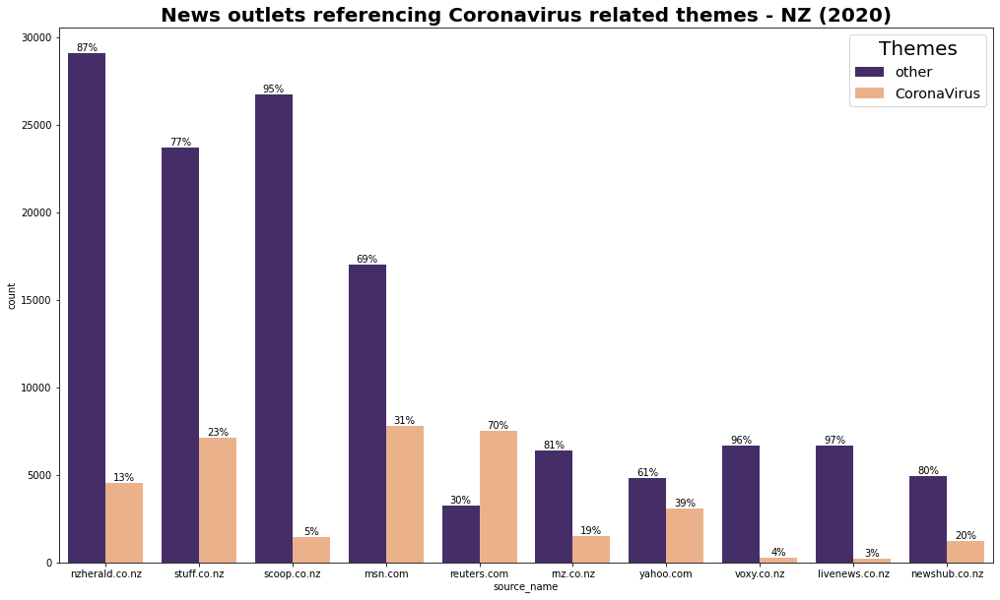

<IPython.core.display.Javascript object>

In [30]:
plt.figure(figsize=(17,10))
ax=sns.countplot(x=df_nz.source_name ,data=df_nz, hue = df_nz.themes_filtered, order = df_nz.source_name.value_counts().index[:10],palette=['#432371',"#FAAE7B"])
ax.set_title('News outlets referencing Coronavirus related themes - NZ (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))

def barPerc(df,xVar,ax):
    '''
    barPerc(): Add percentage for hues to bar plots
    args:
        df: pandas dataframe
        xVar: (string) X variable 
        ax: Axes object (for Seaborn Countplot/Bar plot or
                         pandas bar plot)
    '''
    # 1. how many X categories
    ##   check for NaN and remove
    numX=10
    # 2. The bars are created in hue order, organize them
    bars = ax.patches
    ## 2a. For each X variable
    for ind in range(numX):
        ## 2b. Get every hue bar
        ##     ex. 8 X categories, 4 hues =>
        ##    [0, 8, 16, 24] are hue bars for 1st X category
        hueBars=bars[ind:][::numX]
        ## 2c. Get the total height (for percentages)
        total = sum([x.get_height() for x in hueBars])

        # 3. Print the percentage on the bars
        for bar in hueBars:
            ax.text(bar.get_x() + bar.get_width()/2.,
                    bar.get_height(),
                    f'{bar.get_height()/total:.0%}',
                    ha="center",va="bottom")


barPerc(df_nz, df_nz.source_name, ax)
# for p in ax.patches:
#     width = p.get_width()    
#     ax.text(width + 2,       
#             p.get_y() + p.get_height() / 2, 
#             '{:0.1f}%'.format(100 * width/total), 
#             ha = 'left',   
#             va = 'center')  
plt.legend(title = 'Themes',fontsize='x-large', title_fontsize='20')

In [ ]:
(df_nz.source_name.value_counts().index[:10].tolist())

In [ ]:
df.groupby(['source_name','themes']).agg(count=('themes','count'))

In [31]:
df = df_nz[df_nz.source_name.isin(['nzherald.co.nz',
 'stuff.co.nz',
 'scoop.co.nz',
 'msn.com',
 'reuters.com',
 'rnz.co.nz',
 'yahoo.com',
 'voxy.co.nz',
 'livenews.co.nz',
 'newshub.co.nz'])].explode('themes')

<IPython.core.display.Javascript object>

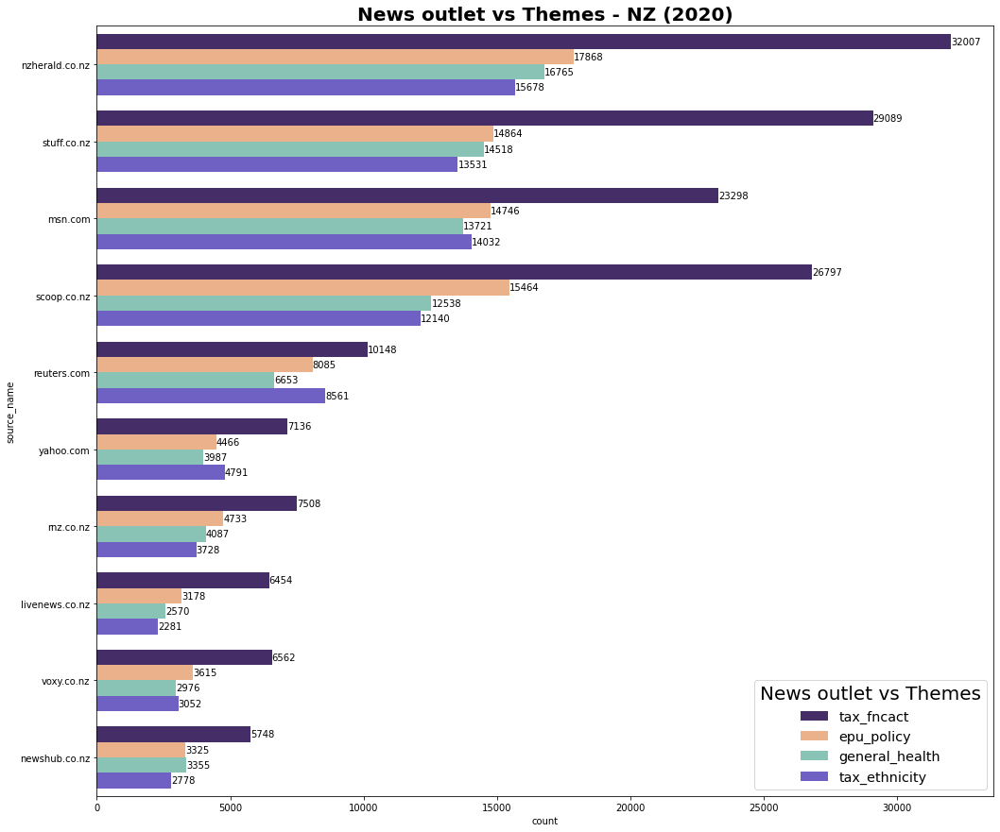

<IPython.core.display.Javascript object>

In [32]:
plt.figure(figsize=(17,15))
ax=sns.countplot(y='source_name' ,data=df, order=df.source_name.value_counts().index[:10].tolist() ,hue='themes',hue_order=df.themes.value_counts().index[1:5],palette=['#432371',"#FAAE7B", "#7fcdbb","#6351D3"])
ax.set_title('News outlet vs Themes - NZ (2020)',  fontsize = 20, loc='center', fontdict=dict(weight='bold'))

for p in ax.patches:
    width = p.get_width()    
    ax.text(width + 2,       
            p.get_y() + p.get_height() / 2, 
            '{:1.0f}'.format(width), 
            ha = 'left',   
            va = 'center')  
plt.legend(title = 'News outlet vs Themes',fontsize='x-large', title_fontsize='20')

In [8]:
# list2 = ['coronavirus']
# # df_nz['themes'] = [[l.split('_') for l in line] for line in df_nz.themes]
# %prun df_nz['themes'] = df_nz.themes.swifter.apply(lambda x: [l.split('_') for l in x])
# doc2 = [nlp(y) for y in list2]

# def get_themes(x):
#     x = list(itertools.chain.from_iterable(x))
#     x = [y.lower() for y in x]
#     doc1 = [nlp(y) for y in x]
#     d = [[x.similarity(y)>0.5 for x in doc2] for y in doc1]
#     if True in list(itertools.chain.from_iterable(d)):
#         return x
# df_nz['themes_filtered'] = df_nz.themes.swifter.apply(lambda s: get_themes(s))


<IPython.core.display.Javascript object>

### News Outlet

#### CSV - 3

In [33]:
dic = df_nz.source_name.value_counts().iloc[:100].to_frame().reset_index().to_dict()['index']

<IPython.core.display.Javascript object>

In [34]:
dic = dict((v,k) for k,v in dic.items())

<IPython.core.display.Javascript object>

In [35]:
df_nz.groupby('source_name').agg({'tone':'mean', 'pos':'mean', 'neg':'mean'}).reset_index().sort_values(by = 'source_name', key = lambda x: x.map(dic)).reset_index(drop = True).to_csv('../csv/NZ_news_outlet_tone.csv', index=False)

<IPython.core.display.Javascript object>

In [36]:
df_nz.date = pd.to_datetime(df_nz.date, errors='coerce')

<IPython.core.display.Javascript object>

#### CSV - 4

In [37]:
df_nz.groupby('source_name').agg(count=('source_name','count')).reset_index().sort_values(by = 'count', ascending = False).reset_index(drop = True).to_csv('../csv/NZ_news_outlet_articles.csv', index=False)

<IPython.core.display.Javascript object>

In [135]:
df_nz.lat = df_nz.lat.fillna(0)
df_nz.lon = df_nz.lon.fillna(0)

<IPython.core.display.Javascript object>

In [142]:
df_map = df_nz.groupby('Region').agg({'tone':'mean'}).reset_index()

<IPython.core.display.Javascript object>

### MAP

In [83]:
df_nz = df_nz.explode('Region')
df_nz['point']=df_nz.explode('Region').Region.map(d)
df_nz[['lat', 'lon']] = pd.DataFrame(df_nz['point'].to_list(), index = df_nz.index)

<IPython.core.display.Javascript object>

In [112]:
import geopandas

<IPython.core.display.Javascript object>

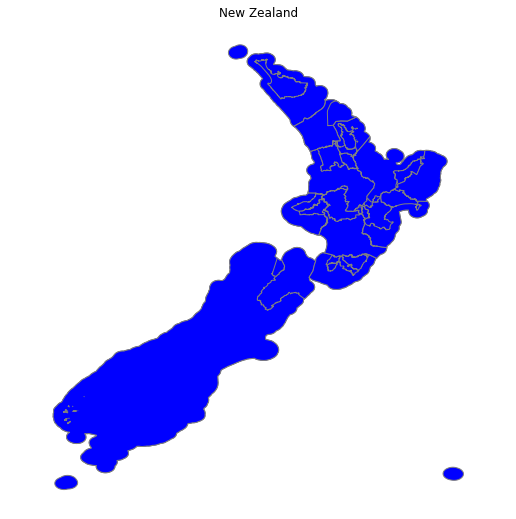

<IPython.core.display.Javascript object>

In [114]:
mx = geopandas.read_file('../Gdelt_scripts/shape/new_zealand_administrative_boundaries_polygon.shp')
f, ax = plt.subplots(1, figsize=(9, 9))
mx.plot(ax=ax, color='blue', edgecolor='grey')
ax.set_axis_off()
ax.set_title('New Zealand')
plt.axis('equal')
plt.show()

In [139]:
mx.head()

,gid,admin_leve,boundary,name,place,population,ref,z_order,way_area,tid,territory_,geometry
0,-556706,2,administrative,New Zealand / Aotearoa,None,4509900,None,0,4.803420e+09,None,None,"POLYGON ((166.19206 -48.06602, 166.19212 -48.0..."
1,-1656388,6,administrative,Invercargill City,None,56200,None,0,1.041610e+09,None,None,"POLYGON ((168.19540 -46.39166, 168.19565 -46.3..."
2,-4555779,6,administrative,Southland District,None,32100,None,0,2.978740e+04,None,None,"POLYGON ((166.57548 -46.09279, 166.57555 -46.0..."
3,-4555779,6,administrative,Southland District,None,32100,None,0,1.114960e+07,None,None,"POLYGON ((166.50512 -46.04934, 166.50670 -46.0..."
4,-4555779,6,administrative,Southland District,None,32100,None,0,4.669570e+03,None,None,"POLYGON ((166.54312 -46.03337, 166.54314 -46.0..."


<IPython.core.display.Javascript object>

In [144]:
import folium
from folium.plugins import FastMarkerCluster
from folium.plugins import HeatMap
# folium_map = folium.Map(location=[59.338315,18.089960],
#  zoom_start=2,
#  tiles='CartoDB dark_matter')

<IPython.core.display.Javascript object>

In [136]:
FastMarkerCluster(data=list(zip(df_nz['lat'].values, df_nz['lon'].values))).add_to(folium_map)
folium.LayerControl().add_to(folium_map)
folium_map

<IPython.core.display.Javascript object>

In [137]:
(-41.5000831, 172.8344077)

(-41.5000831, 172.8344077)

<IPython.core.display.Javascript object>

In [138]:
nz_state = folium.Map(location=[-41.5000831, 172.8344077], zoom_start=3)

<IPython.core.display.Javascript object>